<div style="display: flex; background-color: RGB(255,114,0);" >

# PROJET - Bonheur World <mark>Exploration des données et nettoyage</mark>
</div>

<div style="display: flex; background-color: Blue; padding: 15px;" >

## 1.Mission 
</div>

<div style="display: flex; background-color: Green; padding: 7px;" >

### 1.1. Rappel sur sujet
</div>

Challenge goals

How accurately can we predict regional temperature anomalies based on past and neighbouring climate observations ?

Dans cette étude de cas, nous formerons un algorithme d'apprentissage automatique non supervisé pour regrouper les pays en fonction de caractéristiques telles que la production économique, le soutien social, l'espérance de vie, la liberté, l'absence de corruption et la générosité. Le Rapport sur le bonheur dans le monde détermine l'état du bonheur mondial. Les scores de bonheur et les données de classement ont été collectés en demandant aux individus de classer leur vie de 0 (la pire vie possible) à 10 (la meilleure vie possible).         

- Un notebook contenant les fonctions permettant le prétraitement des données ainsi que les résultats du clustering (en y incluant des représentations graphiques) ....
- Un support de présentation qui présente la démarche et les résultats du clustering.

<div style="display: flex; background-color: Green; padding: 7px;" >

### 1.2. Description du notebook
</div>

Ce note book, a pour objectif d'explorer les données et d'effectuer le nettoyage.

<div style="display: flex; background-color: Green; padding: 7px;" >

### 1.3. Description des données
</div>

- country_official : nom officiel du pays
- country : nom du pays reçu à l'origine
- year : année
- score : score du bonheur
- PIB : PIB par habitant
- Soutien : Soutien social
- Esperance vie BS : Espérance de vie en Bonne Santé
- Liberte des choix de vie : 
- Generosite : la générosité perçue
- Corruption : le faible niveau de corruption perçue
- Regional indicator
- id_country : identifiant officiel du pays
- alpha3 : code alpha3 officiel du pays
- alpha2 : code alpha2 officiel du pays
- continent_code : code continent officiel du pays
- latitude : latitude du pays
- longitude : longitude du pays
- Annual Sunshine : durée d'ensoleillement du pays
- Annual Sunshine NCDC Computed
- deaths_rural_urban : nombre de morts en zone urbaine
- divorces : nombre de divorce
- Precipitations in million cubic metres : volume de précipitations
- rate of Population connected to wastewater collecting system : ratio de la population avec l'eau courante
- rate of Population connected to wastewater treatment : ratio de la population connectée au tout à l'égout
- gini : indice de gini
- intentional homicide victims Female nb : nombre de femmes victimes d'homicide 
- intentional homicide victims Male nb : nombre d'hommes victimes d'homicide 
- Homicide victime nb : nombre de victimes d'homicide 

In [1]:
from os import getcwd
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import missingno as msno
from tqdm import tqdm
import csv
from bonheur_bed_ara import *
from IPython.core.display import HTML
import plotly.express as px

<div style="display: flex; background-color: Blue; padding: 15px;" >

## 2.Chargement des données
</div>

In [2]:
# ---------------------------------------------------------------------------------------------
#                               MAIN
# ---------------------------------------------------------------------------------------------
verbose = False
force_reloading = True

# Récupère le répertoire du programme
file_path = getcwd() + "\\"
data_set_path = file_path + "dataset\\"
country_col_name = "country"
country_official_col_name = "country_official"
data_set_file_name = "DATA_SET_FULL.csv"

print(f"Current execution path : {file_path}")
print(f"Dataset path : {data_set_path}")

Current execution path : c:\Users\User\WORK\workspace-ia\PROJETS\projet_bonheur_bed\
Dataset path : c:\Users\User\WORK\workspace-ia\PROJETS\projet_bonheur_bed\dataset\


<div style="display: flex; background-color: Green; padding: 7px;" >

### 2.1. Chargement
</div>

Le code continent `NA` pour `North America` est interprété comme un NAN, il faut donc en tenir compte au chargement des données.

In [3]:
# Le code continent North American = NA était interprété en tant que NaN et non sa valeur
df_origin = pd.read_csv(data_set_path+data_set_file_name, quoting=csv.QUOTE_NONNUMERIC, na_values=["", np.nan], keep_default_na=False, sep=',')
df_origin = df_origin.sort_values(by=[country_official_col_name, "year"])

print(f"{df_origin.shape} données chargées ------> {list(df_origin.columns)}")
df_origin.head()

(2359, 28) données chargées ------> ['country_official', 'country', 'year', 'score', 'PIB', 'Soutien', 'Esperance vie BS', 'Liberte des choix de vie', 'Generosite', 'Corruption', 'Regional indicator', 'id_country', 'alpha3', 'alpha2', 'continent_code', 'latitude', 'longitude', 'Annual Sunshine', 'Annual Sunshine NCDC Computed', 'deaths_rural_urban', 'divorces', 'Precipitations in million cubic metres', 'rate of Population connected to wastewater collecting system', 'rate of Population connected to wastewater treatment', 'gini', 'intentional homicide victims Female nb', 'intentional homicide victims Male nb', 'Homicide victime nb']


,country_official,country,year,score,PIB,Soutien,Esperance vie BS,Liberte des choix de vie,Generosite,Corruption,...,Annual Sunshine NCDC Computed,deaths_rural_urban,divorces,Precipitations in million cubic metres,rate of Population connected to wastewater collecting system,rate of Population connected to wastewater treatment,gini,intentional homicide victims Female nb,intentional homicide victims Male nb,Homicide victime nb
443,Arab Republic of Egypt,Egypt,2005.0,5.168,9.036,0.848,59.70,0.817,NaN,NaN,...,3293.3,450646.0,65047.0,1300.0,NaN,NaN,NaN,63.0,459.0,10962.0
828,Arab Republic of Egypt,Egypt,2007.0,5.541,9.135,0.686,59.82,0.609,-0.121,NaN,...,3790.8,450596.0,77878.0,1300.0,NaN,NaN,NaN,163.0,517.0,14280.0
1082,Arab Republic of Egypt,Egypt,2008.0,4.632,9.186,0.738,59.88,NaN,-0.087,0.914,...,3790.8,461934.0,84430.0,NaN,NaN,NaN,NaN,110.0,856.0,20286.0
936,Arab Republic of Egypt,Egypt,2009.0,5.066,9.213,0.744,59.94,0.611,-0.100,0.801,...,3298.9,476592.0,141467.0,NaN,NaN,NaN,NaN,193.0,719.0,19152.0
961,Arab Republic of Egypt,Egypt,2010.0,4.669,9.244,0.769,60.00,0.486,-0.076,0.826,...,3666.4,483385.0,149376.0,NaN,NaN,NaN,NaN,197.0,1642.0,38619.0


<div style="display: flex; background-color: Green; padding: 7px;" >

### 2.2. Exploration de la forme
</div>

In [4]:
df_origin[df_origin['continent_code'].isna()]

,country_official,country,year,score,PIB,Soutien,Esperance vie BS,Liberte des choix de vie,Generosite,Corruption,...,Annual Sunshine NCDC Computed,deaths_rural_urban,divorces,Precipitations in million cubic metres,rate of Population connected to wastewater collecting system,rate of Population connected to wastewater treatment,gini,intentional homicide victims Female nb,intentional homicide victims Male nb,Homicide victime nb


<div style="display: flex; background-color: indigo;" >

#### Encodage des continents
</div>

In [27]:
# Encodage des continents :
from sklearn.preprocessing import LabelEncoder

In [34]:
transformer_continent = LabelEncoder()
df_origin['continent_encode'] = transformer_continent.fit_transform(df_origin['continent_code'])
df_origin = df_origin[['country_official', 'country', 'continent_code','continent_encode','year', 'score', 'PIB', 'Soutien',
       'Esperance vie BS', 'Liberte des choix de vie', 'Generosite',
       'Corruption', 'Regional indicator', 'alpha3', 'alpha2', 'latitude', 'longitude', 'id_country', 'Annual Sunshine',
       'Annual Sunshine NCDC Computed', 'deaths_rural_urban', 'divorces',
       'Precipitations in million cubic metres',
       'rate of Population connected to wastewater collecting system',
       'rate of Population connected to wastewater treatment', 'gini',
       'intentional homicide victims Female nb',
       'intentional homicide victims Male nb', 'Homicide victime nb'
       ]]

<div style="display: flex; background-color: indigo;" >

#### Typage des données
</div>

In [15]:
df_origin["year"] = df_origin["year"].astype(int)
df_origin["id_country"] = df_origin["id_country"].astype(int)

In [29]:
df_origin.dtypes

country_official                                                 object
country                                                          object
year                                                              int32
score                                                           float64
PIB                                                             float64
Soutien                                                         float64
Esperance vie BS                                                float64
Liberte des choix de vie                                        float64
Generosite                                                      float64
Corruption                                                      float64
Regional indicator                                               object
id_country                                                        int32
alpha3                                                           object
alpha2                                                          

In [7]:
df_origin.describe(include="all")

,country_official,country,year,score,PIB,Soutien,Esperance vie BS,Liberte des choix de vie,Generosite,Corruption,...,deaths_rural_urban,divorces,Precipitations in million cubic metres,rate of Population connected to wastewater collecting system,rate of Population connected to wastewater treatment,gini,intentional homicide victims Female nb,intentional homicide victims Male nb,Homicide victime nb,id_country
count,2359,2359,2359.000000,2359.000000,2265.000000,2274.000000,2242.000000,2256.000000,2212.000000,2183.000000,...,1.035000e+03,9.460000e+02,5.340000e+02,461.000000,386.000000,841.000000,1063.000000,1057.000000,1.055000e+03,2359.000000
unique,164,190,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,Arab Republic of Egypt,Egypt,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,17,17,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,NaN,NaN,2014.507842,5.442263,8.841420,0.817168,59.332300,0.730743,0.008151,0.707741,...,3.624518e+05,7.289547e+04,7.909549e+05,66.355360,67.537196,36.906421,599.159925,2555.536424,6.635291e+04,413.176346
std,NaN,NaN,4.768411,1.121303,2.249192,0.137225,17.045576,0.151687,0.162127,0.233816,...,1.180071e+06,2.678078e+05,2.366401e+06,25.828580,33.103334,7.890536,2207.075003,7445.275762,1.901684e+05,265.004992
min,NaN,NaN,2005.000000,2.375000,0.000000,0.000000,0.000000,0.000000,-0.335000,0.000000,...,1.216000e+03,4.200000e+01,1.540000e+01,4.900000,0.000000,24.000000,0.000000,0.000000,0.000000e+00,-1.000000
25%,NaN,NaN,2011.000000,4.624500,8.167000,0.746000,56.400000,0.636000,-0.106000,0.653000,...,2.878850e+04,5.162250e+03,3.251570e+04,51.040001,46.625000,30.900000,22.000000,45.000000,1.407000e+03,188.000000
50%,NaN,NaN,2015.000000,5.383000,9.370000,0.838000,64.800000,0.750500,-0.013000,0.791000,...,8.087600e+04,1.310950e+04,1.010552e+05,69.800003,80.299999,35.400000,58.000000,162.000000,5.124000e+03,404.000000
75%,NaN,NaN,2019.000000,6.256500,10.263000,0.909000,68.200000,0.853000,0.106000,0.865000,...,2.579000e+05,3.583625e+04,3.659614e+05,87.000000,97.000000,42.000000,202.000000,752.000000,2.022300e+04,642.000000


In [8]:
display(HTML(df_origin[df_origin["country_official"]=='French Republic'].head().to_html()))

,country_official,country,year,score,PIB,Soutien,Esperance vie BS,Liberte des choix de vie,Generosite,Corruption,Regional indicator,id_country,alpha3,alpha2,continent_code,latitude,longitude,Annual Sunshine,Annual Sunshine NCDC Computed,deaths_rural_urban,divorces,Precipitations in million cubic metres,rate of Population connected to wastewater collecting system,rate of Population connected to wastewater treatment,gini,intentional homicide victims Female nb,intentional homicide victims Male nb,Homicide victime nb,id_country
185,French Republic,France,2005,7.093,10.642,0.940,71.30,0.895,NaN,0.688,Western Europe,250.0,FRA,FR,EU,46.71109,1.719104,1831.9,1831.8,527533.0,152020.0,401743.00000,NaN,NaN,29.8,NaN,NaN,NaN,250
630,French Republic,France,2006,6.583,10.659,0.944,71.48,0.789,0.126,0.699,Western Europe,250.0,FRA,FR,EU,46.71109,1.719104,1831.2,1831.2,516416.0,135910.0,509886.18750,NaN,NaN,29.7,NaN,NaN,NaN,250
628,French Republic,France,2008,7.008,10.674,0.935,71.84,0.833,-0.031,0.669,Western Europe,250.0,FRA,FR,EU,46.71109,1.719104,2835.5,2835.5,532131.0,129379.0,562079.68750,NaN,NaN,33.0,NaN,NaN,NaN,250
646,French Republic,France,2009,6.283,10.639,0.918,72.02,0.798,-0.082,0.654,Western Europe,250.0,FRA,FR,EU,46.71109,1.719104,1749.6,1749.7,538116.0,127578.0,474837.40625,NaN,NaN,32.7,NaN,NaN,NaN,250
298,French Republic,France,2010,6.798,10.654,0.943,72.20,0.850,-0.104,0.623,Western Europe,250.0,FRA,FR,EU,46.71109,1.719104,2737.3,2740.1,540469.0,130810.0,502397.18750,82.0,100.0,33.7,NaN,NaN,NaN,250


<div style="display: flex; background-color: Green; padding: 7px;" >

### 2.2. Visualisation
</div>

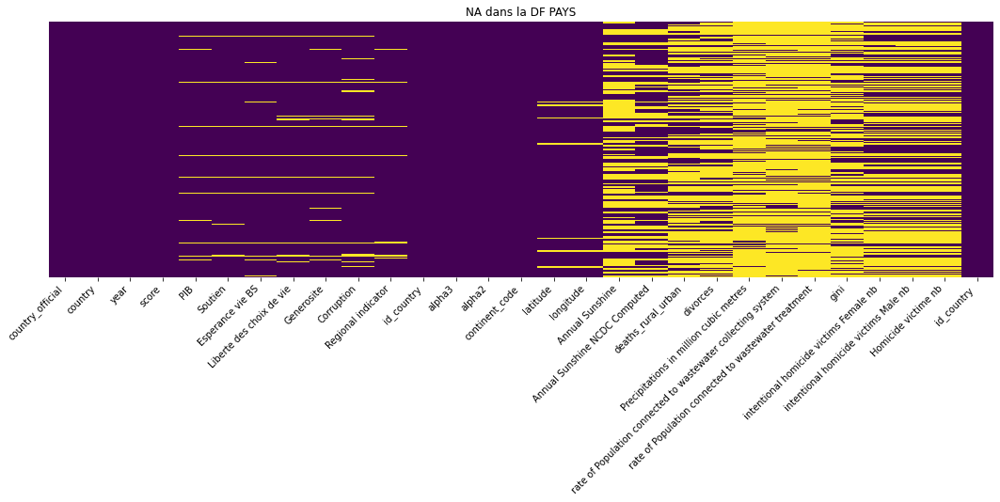

In [9]:
figure, ax = color_graph_background(1,1)
sns.heatmap(df_origin.isnull(), yticklabels=False,cbar=False, cmap='viridis')
plt.xticks(rotation=45, ha="right", fontsize=10)
plt.title("NA dans la DF PAYS")
figure.set_size_inches(18, 5, forward=True)
plt.show()

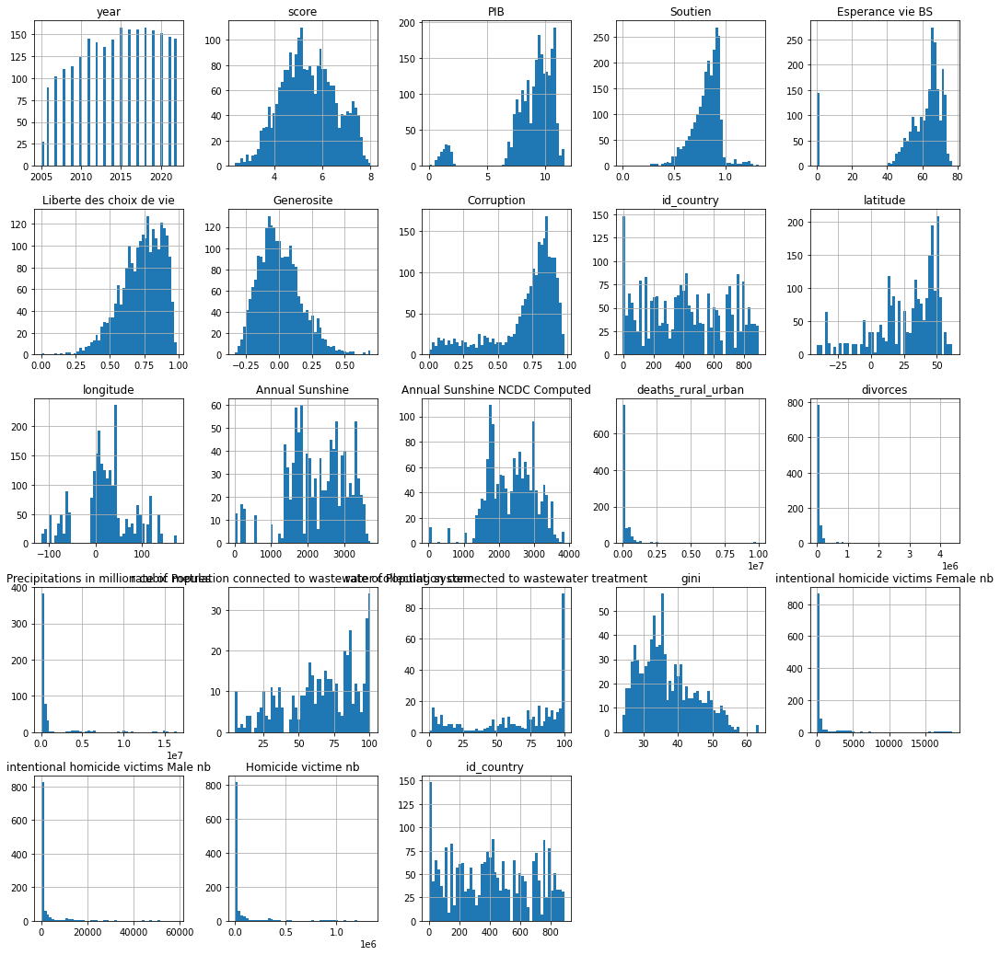

In [10]:
df_origin.hist(figsize=(18,18),bins=50)
plt.show()

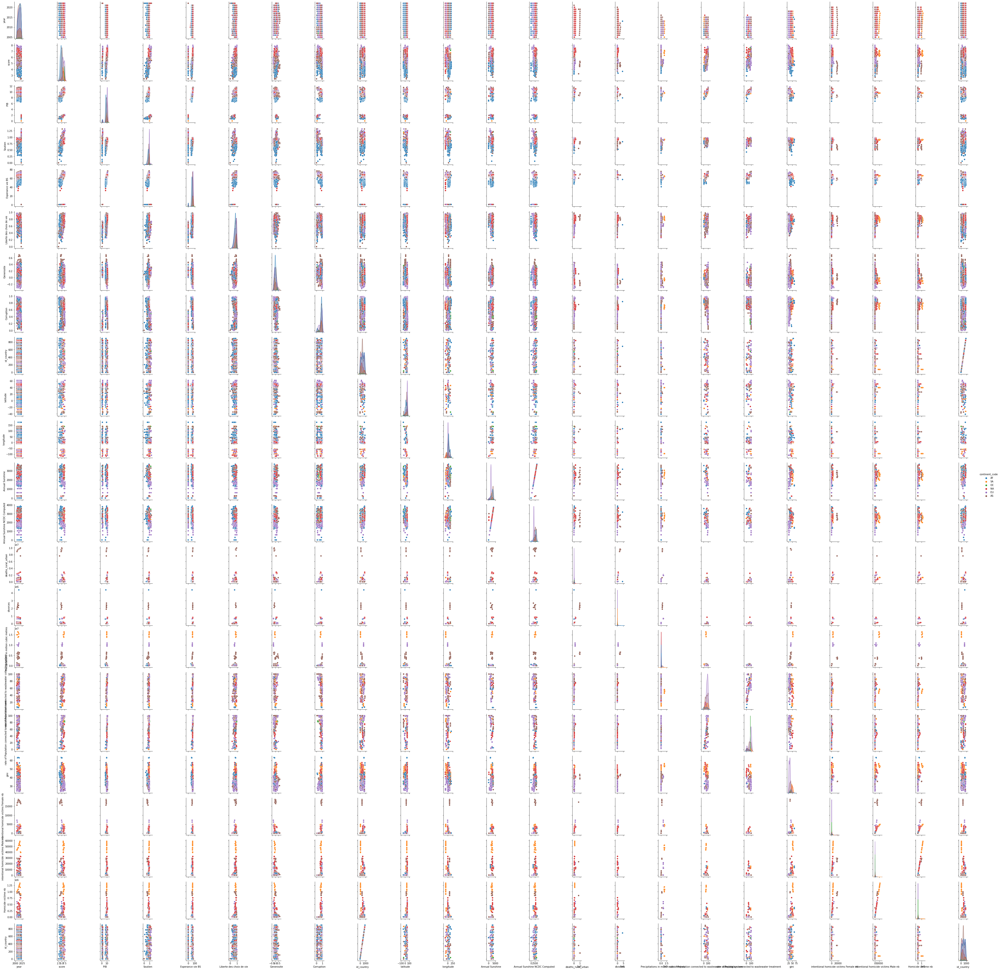

In [11]:
sns.pairplot(df_origin, hue='continent_code')
plt.show()

Les variables : 
- `Annual Sunshine` et `Annual Sunshine NCDC Computed` sont très fortement corrélée (0.84), une seule de ces 2 variables est donc suffisantes, suppression de `Annual Sunshine`
- `intentional homicide victims Male nb` et `intentional homicide victims Female nb`, `Homicide victime nb` sont très fortement corrélée (0.98), une seule de ces 2 variables est donc suffisantes, suppression de `intentional homicide victims Male nb` et de `intentional homicide victims Female nb`

In [35]:
df_clean = df_origin.copy()
df_clean = df_clean.drop(['Annual Sunshine', 'intentional homicide victims Male nb', 'intentional homicide victims Female nb'], axis=1)

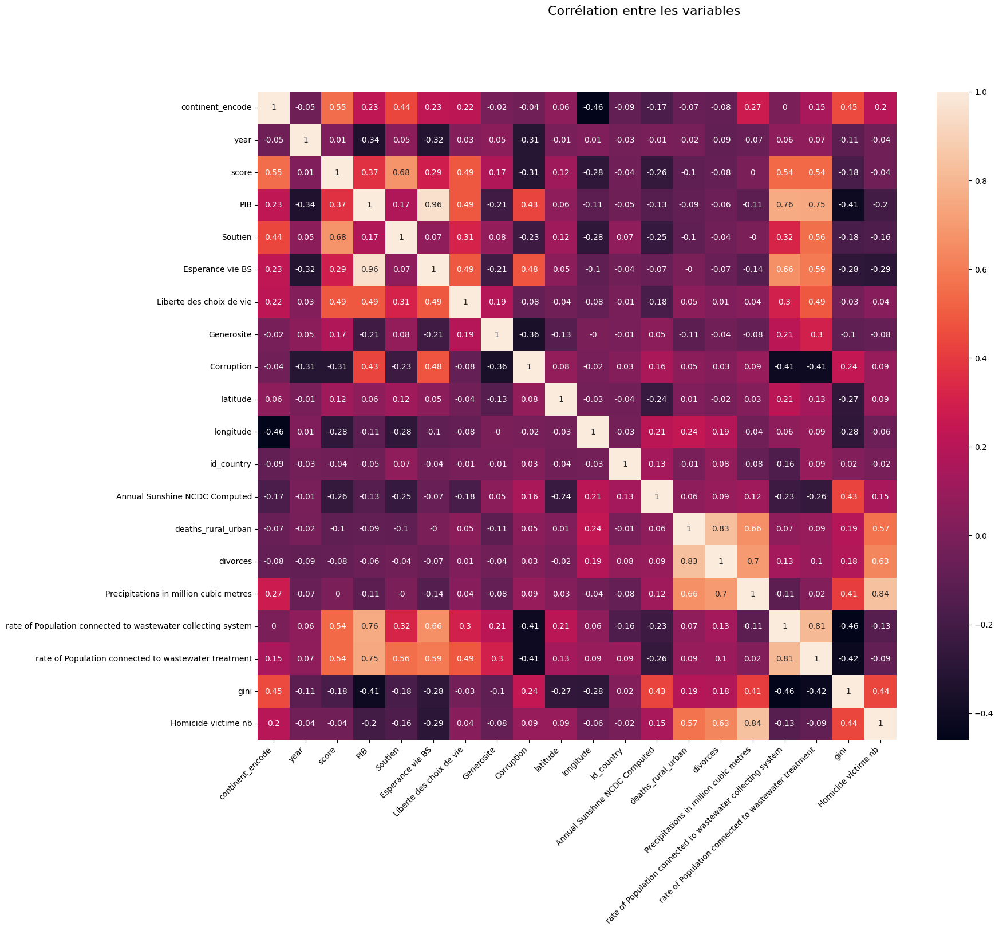

In [36]:
##on utilise data.corr et le heatmap de seborn
corr_df = df_clean.corr()
if verbose>1:
    print(corr_df, "\n")
corr_df = corr_df.round(2)
figure, ax = color_graph_background(1,1)
figure.set_size_inches(18, 15, forward=True)
figure.set_dpi(100)
figure.suptitle("Corrélation entre les variables", fontsize=16)
sns.heatmap(corr_df, annot=True)
plt.xticks(rotation=45, ha="right", fontsize=10)
plt.show()

<div style="display: flex; background-color: Green; padding: 7px;" >

### 2.2. Création de la DF des moyennes
</div>

In [38]:
df_origin.columns

Index(['country_official', 'country', 'continent_code', 'continent_encode',
       'year', 'score', 'PIB', 'Soutien', 'Esperance vie BS',
       'Liberte des choix de vie', 'Generosite', 'Corruption',
       'Regional indicator', 'alpha3', 'alpha2', 'latitude', 'longitude',
       'id_country', 'Annual Sunshine', 'Annual Sunshine NCDC Computed',
       'deaths_rural_urban', 'divorces',
       'Precipitations in million cubic metres',
       'rate of Population connected to wastewater collecting system',
       'rate of Population connected to wastewater treatment', 'gini',
       'intentional homicide victims Female nb',
       'intentional homicide victims Male nb', 'Homicide victime nb'],
      dtype='object')

In [40]:
group_cols = list(df_origin.columns)
group_cols.remove("year")
mean_cols = {'score', 'PIB', 'Soutien', 'Esperance vie BS', 'Liberte des choix de vie', 'Generosite', 'Corruption', 'Annual Sunshine', 'Annual Sunshine NCDC Computed', 'deaths_rural_urban', 'divorces', 'Precipitations in million cubic metres', 'rate of Population connected to wastewater collecting system', 'rate of Population connected to wastewater treatment', 'gini', 'intentional homicide victims Female nb', 'intentional homicide victims Male nb', 'Homicide victime nb'}
mean_dic = {}
for c in mean_cols:
   group_cols.remove(c)
   mean_dic[c] = ['mean']
   
df_mean = df_origin.groupby(group_cols, as_index=False).agg(mean_dic)
df_mean = df_mean.sort_values(by=[('score', 'mean')], ascending=False)
df_mean = df_mean.reset_index()
df_mean = df_mean.drop("index", axis=1)
df_mean.head()

C:\Users\User\AppData\Local\Temp\ipykernel_49436\1668771800.py:12: PerformanceWarning: dropping on a non-lexsorted multi-index without a level parameter may impact performance.
  df_mean = df_mean.drop("index", axis=1)


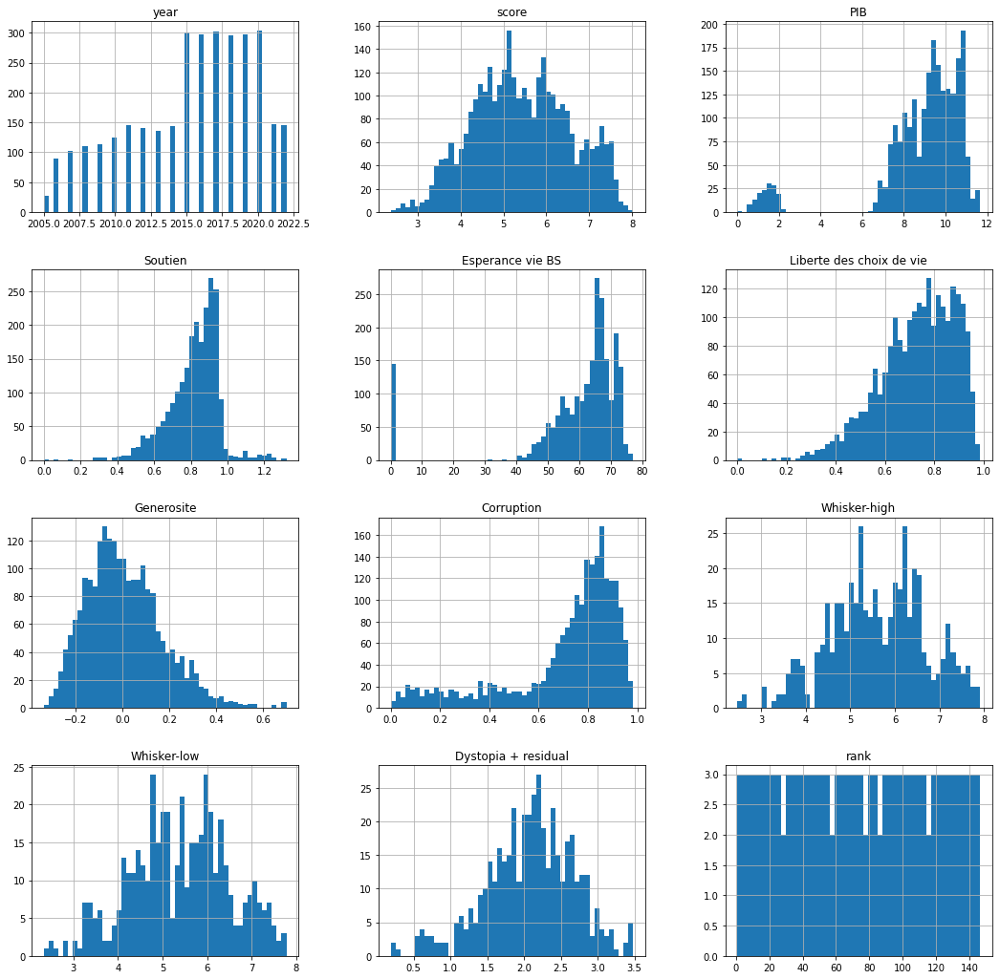

In [ ]:
figure, ax = color_graph_background(1,1)
df_mean.hist(figsize=(18,18),bins=50)
plt.show()

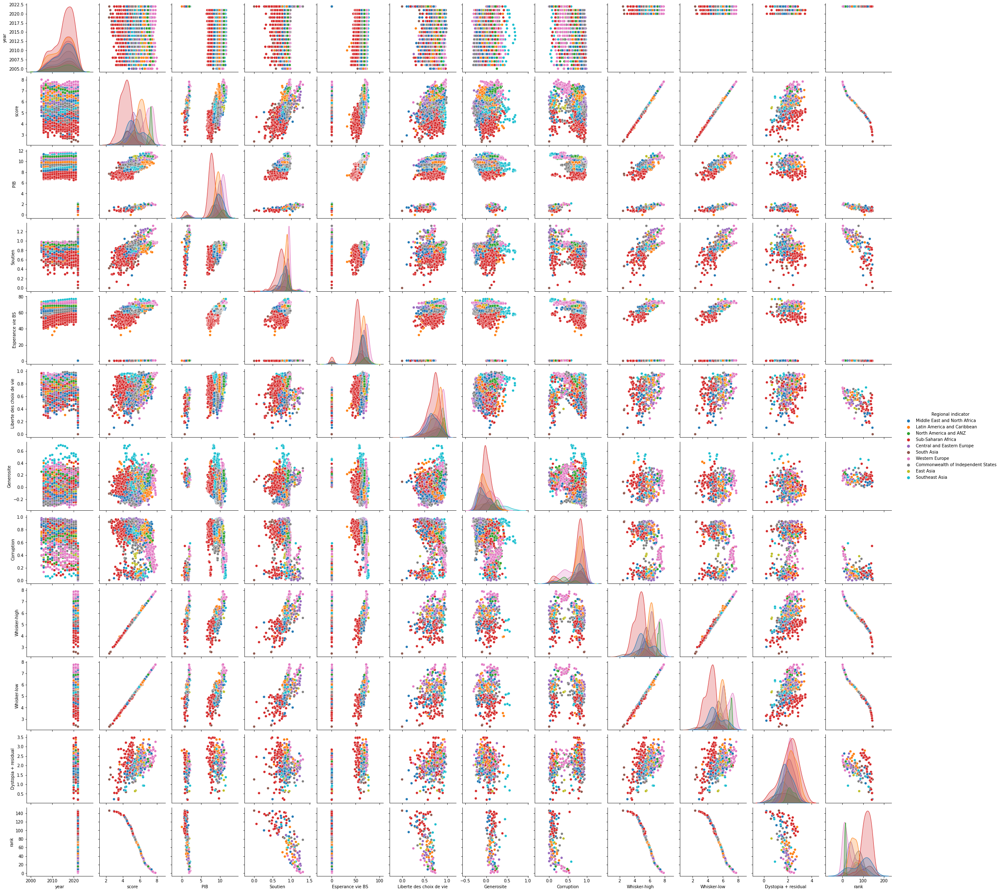

In [ ]:
figure, ax = color_graph_background(1,1)
sns.pairplot(df_mean, hue='continent_code')
plt.show()

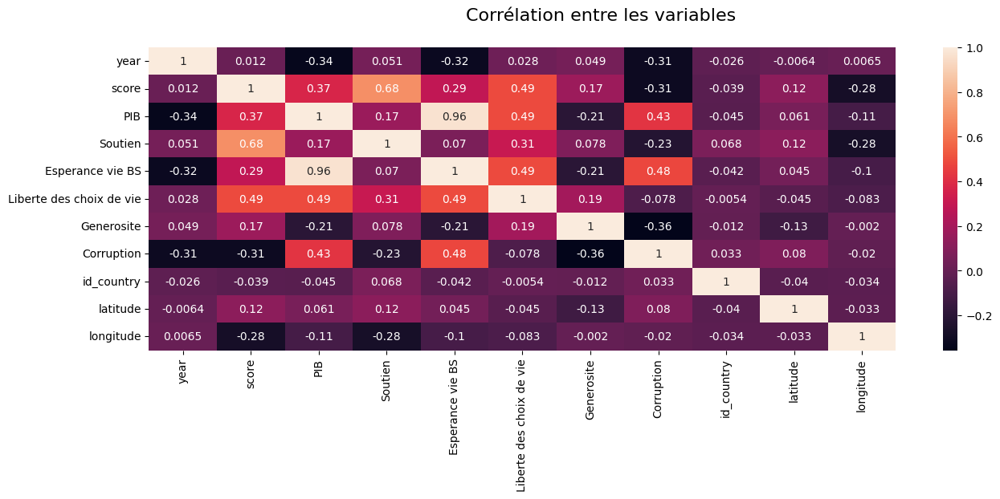

In [ ]:
##on utilise data.corr et le heatmap de seborn
corr_df = df_mean.corr()
if verbose>1:
    print(corr_df, "\n")
figure, ax = color_graph_background(1,1)
figure.set_size_inches(15, 5, forward=True)
figure.set_dpi(100)
figure.suptitle("Corrélation entre les variables", fontsize=16)
sns.heatmap(corr_df, annot=True)
plt.show()

<div style="display: flex; background-color: Blue; padding: 15px;" >

# 3.Exploration des données
</div>

<div style="display: flex; background-color: Green; padding: 7px;" >

### 2.2. Evolution par pays
</div>

In [ ]:
df_score = df_origin[['country_official', 'country','continent_code', 'Regional indicator', 'alpha3', 'alpha2',  'latitude', 'longitude', 'year', 'score']].copy()

In [99]:
score_only_by_country = df_score[['country_official', 'country','continent_code','year', 'score']].copy()
# TODO trier les données sur la moyenne du score, puis réorganiser

score_only_by_country = score_only_by_country.sort_values(by=['country_official', 'year',], ascending=False)
score_only_by_country = score_only_by_country.reset_index()
score_only_by_country = score_only_by_country.set_index("country_official")
score_only_by_country = score_only_by_country.drop("index", axis=1)
score_only_by_country.head(30)


,Regional indicator,2015,2016,2017,2018,2019,2020,2021,2022
country_official,,,,,,,,,
Swiss Confederation,Western Europe,7.587,7.509,7.494,7.487,7.480,7.560,7.571,7.512
Republic of Iceland,Western Europe,7.561,7.501,7.504,7.495,7.494,7.504,7.554,7.557
Kingdom of Denmark,Western Europe,7.527,7.526,7.522,7.555,7.600,7.646,7.620,7.636
Kingdom of Norway,Western Europe,7.522,7.498,7.537,7.594,7.554,7.488,7.392,7.365
Canada,North America and ANZ,7.427,7.404,7.316,7.328,7.278,7.232,7.103,7.025
Republic of Finland,Western Europe,7.406,7.413,7.469,7.632,7.769,7.809,7.842,7.821
Kingdom of the Netherlands,Western Europe,7.378,7.339,7.377,7.441,7.488,7.449,7.464,7.415
Kingdom of Sweden,Sub-Saharan Africa,7.364,7.291,7.284,7.314,7.343,7.353,4.308,7.384
New Zealand,North America and ANZ,7.286,7.334,7.314,7.324,7.307,7.300,7.277,7.200


In [96]:
n_top = 30
score_only_by_country_t = score_only_by_country[['2015', '2016', '2017', '2018', '2019', '2020', '2021', '2022']].head(n_top).T
score_only_by_country_t.head()

country_official,Swiss Confederation,Republic of Iceland,Kingdom of Denmark,Kingdom of Norway,Canada,Republic of Finland,Kingdom of the Netherlands,Kingdom of Sweden,New Zealand,Australia,...,United Kingdom of Great Britain and Northern Ireland,Venezuela,Republic of Singapore,Republic of Panama,Federal Republic of Germany,Republic of Chile,State of Qatar,French Republic,Argentine Republic,Czech Republic
2015,7.587,7.561,7.527,7.522,7.427,7.406,7.378,7.364,7.286,7.284,...,6.867,6.800,6.798,6.786,6.750,6.670,6.611,6.575,6.574,6.505
2016,7.509,7.501,7.526,7.498,7.404,7.413,7.339,7.291,7.334,7.313,...,6.725,6.084,6.739,6.701,6.994,6.705,6.375,6.478,6.650,6.596
2017,7.494,7.504,7.522,7.537,7.316,7.469,7.377,7.284,7.314,7.284,...,6.714,5.250,6.572,6.452,6.951,6.652,6.375,6.442,6.599,6.609
2018,7.487,7.495,7.555,7.594,7.328,7.632,7.441,7.314,7.324,7.272,...,7.190,4.806,6.343,6.430,6.965,6.476,6.374,6.489,6.388,6.711
2019,7.480,7.494,7.600,7.554,7.278,7.769,7.488,7.343,7.307,7.228,...,7.054,4.707,6.262,6.321,6.985,6.444,6.374,6.592,6.086,6.852


In [97]:
# Correction de la valeur de la Suède
print(score_only_by_country_t.loc["2021","Kingdom of Sweden"])
score_only_by_country_t.loc["2021","Kingdom of Sweden"] = score_only_by_country_t["Kingdom of Sweden"].mean()
score_only_by_country_t.loc["2021","Kingdom of Sweden"]

4.308


6.955125

In [98]:
fig = px.line(score_only_by_country_t, markers=True, title=f"Evolution des scores du top {n_top} en 2015.")
fig.update_layout(
    xaxis_title="Années",
    yaxis_title="Score",
    legend_title="Nom officiel des pays",
)
fig.show()

<div style="display: flex; background-color: indigo;" >

#### 2.2.X. Evolution par région
</div>

<div style="display: flex; background-color: green;" >

## 1.1. Visualisation des données
</div>


In [ ]:
print(the_df.shape)
print(the_df_by_line.shape)


In [ ]:
the_df.head()

In [ ]:
the_df_by_line.head()

In [ ]:
the_df.dtypes

In [ ]:
the_df_by_line.dtypes

In [ ]:
the_df.describe(include="all")

In [ ]:
the_df_by_line.describe(include="all")

In [ ]:
the_df.hist(figsize=(25,25),bins=50)

In [ ]:
the_df_by_line.hist(figsize=(25,25),bins=50)

<div style="display: flex; background-color: green;" >

## 1.2. Analyse des NaN
</div>


In [ ]:
sns.heatmap(the_df.isnull(), yticklabels=False,cbar=False, cmap='viridis')

In [ ]:
msno.heatmap(the_df)

In [ ]:
# Avant nettoyage
msno.matrix(the_df)

In [ ]:
msno.bar(the_df)

<div style="display: flex; background-color: green;" >

## 1.2. Corrélations entre les données
</div>


In [ ]:
df_origine["score_int"] = round(df_origine["Score"])
df_origine["score_int"] = df_origine["score_int"].astype('int')

In [ ]:
sns.pairplot(df_origine, hue="score_int")

In [ ]:
draw_correlation_graphe(df_origine, "Corrélation entre les variables", verbose=verbose,fontsize=12)

<div style="display: flex; background-color: green;" >

## 1.3. Visualisation des outliers
</div>


In [ ]:
cols = get_numeric_columns_names(df_origine)
for column_name in cols:
    q_low, q_hi,iqr, q_min, q_max = get_outliers_datas(df_origine, column_name)
    graphe_outliers(df_origine, column_name, q_min, q_max)

<div style="display: flex; background-color: green;" >

## 1.4. Analyse des autres doublons possible
</div>


# Chargement DF pays

In [ ]:
pays_file_name = "data_set_countries_clean.csv"

<div style="display: flex; background-color: Blue; padding: 15px;" >

## Annexes
</div>

In [ ]:
just to fail

<div style="display: flex; background-color: Green; padding: 7px;" >

### Titre 2
</div>

<div style="display: flex; background-color: indigo;" >

#### Titre 3
</div>

<div style="display: flex; background-color: Green; padding: 7px;" >

### Nettoyage des pays par année dans la DF 
</div>

In [ ]:
diff = df_origine_light[df_origine_light["2019-country_origin"] != df_origine_light["2019-country"]]
diff = diff[['country_official', 'Regional indicator', '2019-country_origin','2019-country',
       '2020-country_origin', '2020-country', '2021-country_origin', '2021-country', '2022-country_origin', '2022-country' ]]
print(diff[diff["2019-country"].notna()].shape)
diff[diff["2019-country"].notna()]

(6, 10)


,country_official,Regional indicator,2019-country_origin,2019-country,2020-country_origin,2020-country,2021-country_origin,2021-country,2022-country_origin,2022-country
8,Democratic Republic Of The Congo,Sub-Saharan Africa,Congo (Kinshasa),Democratic Republic of the Congo,Congo (Kinshasa),Democratic Republic of the Congo,NaN,NaN,NaN,NaN
24,Hong Kong Special Administrative Region of China,East Asia,Hong Kong,Hong Kong S.A.R. of China,Hong Kong S.A.R. of China,Hong Kong S.A.R. of China,Hong Kong S.A.R. of China,Hong Kong S.A.R. of China,Hong Kong S.A.R. of China,Hong Kong S.A.R. of China
40,Kingdom of Eswatini,Sub-Saharan Africa,Swaziland,Eswatini,Swaziland,Eswatini,Swaziland,Eswatini,Eswatini. Kingdom of,Eswatini
119,Republic of Trinidad and Tobago,Latin America and Caribbean,Trinidad & Tobago,Trinidad and Tobago,Trinidad and Tobago,Trinidad and Tobago,NaN,NaN,NaN,NaN
127,Republic of the Congo,Sub-Saharan Africa,Congo (Brazzaville),Republic of the Congo,Congo (Brazzaville),Republic of the Congo,Congo (Brazzaville),Republic of the Congo,Congo,Congo
131,Republic of the Sudan,Sub-Saharan Africa,South Sudan,Sudan,South Sudan,Sudan,NaN,NaN,NaN,NaN


In [ ]:
diff = df_origine_light[df_origine_light["2019-country_origin"] != df_origine_light["2020-country_origin"]]
diff = diff[['country_official', 'Regional indicator', '2019-country_origin',
       '2020-country_origin', '2019-country','2020-country', '2021-country_origin', '2021-country', '2022-country_origin', '2022-country' ]]
print(diff[diff["2019-country_origin"].notna() & diff["2020-country_origin"].notna()].shape)
diff[diff["2019-country_origin"].notna() & diff["2020-country_origin"].notna()]

(4, 10)


,country_official,Regional indicator,2019-country_origin,2020-country_origin,2019-country,2020-country,2021-country_origin,2021-country,2022-country_origin,2022-country
24,Hong Kong Special Administrative Region of China,East Asia,Hong Kong,Hong Kong S.A.R. of China,Hong Kong S.A.R. of China,Hong Kong S.A.R. of China,Hong Kong S.A.R. of China,Hong Kong S.A.R. of China,Hong Kong S.A.R. of China,Hong Kong S.A.R. of China
107,Republic of North Macedonia,Central and Eastern Europe,North Macedonia,Macedonia,North Macedonia,Macedonia,North Macedonia,North Macedonia,North Macedonia,North Macedonia
119,Republic of Trinidad and Tobago,Latin America and Caribbean,Trinidad & Tobago,Trinidad and Tobago,Trinidad and Tobago,Trinidad and Tobago,NaN,NaN,NaN,NaN
145,The Republic of Cyprus,Western Europe,Northern Cyprus,North Cyprus,Northern Cyprus,Northern Cyprus,North Cyprus,Northern Cyprus,North Cyprus,Northern Cyprus


In [ ]:
diff = df_origine_light[df_origine_light["2020-country_origin"] != df_origine_light["2021-country_origin"]]
diff = diff[['country_official', 'Regional indicator', 
       '2020-country_origin', '2021-country_origin', '2020-country', '2021-country', '2022-country_origin', '2022-country' ]]
print(diff[diff["2020-country_origin"].notna() & diff["2021-country_origin"].notna()].shape)
diff[diff["2020-country_origin"].notna() & diff["2021-country_origin"].notna()]

(1, 8)


,country_official,Regional indicator,2020-country_origin,2021-country_origin,2020-country,2021-country,2022-country_origin,2022-country
107,Republic of North Macedonia,Central and Eastern Europe,Macedonia,North Macedonia,Macedonia,North Macedonia,North Macedonia,North Macedonia


In [ ]:
diff = df_origine_light[df_origine_light["2021-country_origin"] != df_origine_light["2022-country_origin"]]
diff = diff[['country_official', 'Regional indicator', 
       '2021-country_origin', '2022-country_origin', '2021-country', '2022-country' ]]
print(diff[diff["2021-country_origin"].notna() & diff["2022-country_origin"].notna()].shape)
diff[diff["2021-country_origin"].notna() & diff["2022-country_origin"].notna()]

(3, 6)


,country_official,Regional indicator,2021-country_origin,2022-country_origin,2021-country,2022-country
7,Czech Republic,Central and Eastern Europe,Czech Republic,Czechia,Czech Republic,Czech Republic
40,Kingdom of Eswatini,Sub-Saharan Africa,Swaziland,Eswatini. Kingdom of,Eswatini,Eswatini
127,Republic of the Congo,Sub-Saharan Africa,Congo (Brazzaville),Congo,Republic of the Congo,Congo


In [ ]:
diff = df_origine_light[df_origine_light["2020-country_origin"] != df_origine_light["2020-country"]]
diff = diff[['country_official', 'Regional indicator', '2019-country_origin','2019-country',
       '2020-country_origin', '2020-country', '2021-country_origin', '2021-country', '2022-country_origin', '2022-country' ]]
print(diff[diff["2020-country"].notna()].shape)
diff[diff["2020-country"].notna()]

(6, 10)


,country_official,Regional indicator,2019-country_origin,2019-country,2020-country_origin,2020-country,2021-country_origin,2021-country,2022-country_origin,2022-country
8,Democratic Republic Of The Congo,Sub-Saharan Africa,Congo (Kinshasa),Democratic Republic of the Congo,Congo (Kinshasa),Democratic Republic of the Congo,NaN,NaN,NaN,NaN
40,Kingdom of Eswatini,Sub-Saharan Africa,Swaziland,Eswatini,Swaziland,Eswatini,Swaziland,Eswatini,Eswatini. Kingdom of,Eswatini
156,Republic of China,East Asia,NaN,NaN,Taiwan Province of China,Republic of China,Taiwan Province of China,Republic of China,Taiwan Province of China,Republic of China
127,Republic of the Congo,Sub-Saharan Africa,Congo (Brazzaville),Republic of the Congo,Congo (Brazzaville),Republic of the Congo,Congo (Brazzaville),Republic of the Congo,Congo,Congo
131,Republic of the Sudan,Sub-Saharan Africa,South Sudan,Sudan,South Sudan,Sudan,NaN,NaN,NaN,NaN
145,The Republic of Cyprus,Western Europe,Northern Cyprus,Northern Cyprus,North Cyprus,Northern Cyprus,North Cyprus,Northern Cyprus,North Cyprus,Northern Cyprus


In [ ]:
diff = df_origine_light_completed2[df_origine_light_completed2["2020-country_origin"] != df_origine_light_completed2["country_origin"]]
diff = diff[['country_official', 'Regional indicator', 'country_origin','country',
       '2020-country_origin' ]]
diff

,country_official,Regional indicator,country_origin,country,2020-country_origin
16,Federal Republic of Somalia,NaN,Somalia,Somalia,NaN
24,Hong Kong Special Administrative Region of China,East Asia,Hong Kong,Hong Kong S.A.R. of China,Hong Kong S.A.R. of China
37,Kingdom of Bhutan,NaN,Bhutan,Bhutan,NaN
107,Republic of North Macedonia,Central and Eastern Europe,North Macedonia,North Macedonia,Macedonia
119,Republic of Trinidad and Tobago,Latin America and Caribbean,Trinidad & Tobago,Trinidad and Tobago,Trinidad and Tobago
140,State of Qatar,NaN,Qatar,Qatar,NaN
142,Syria,NaN,Syria,Syria,NaN
143,Taiwan,NaN,Taiwan,Taiwan,NaN
145,The Republic of Cyprus,Western Europe,Northern Cyprus,Northern Cyprus,North Cyprus


In [ ]:
try:
    df_origine_light_completed2 = df_origine_light_completed2.drop("2020-country_origin", axis=1)
except:
    pass
diff = df_origine_light_completed2[df_origine_light_completed2["2021-country_origin"] != df_origine_light_completed2["country_origin"]]
diff = diff[['country_official', 'Regional indicator', 'country_origin','country',
       '2021-country_origin' ]]
diff

,country_official,Regional indicator,country_origin,country,2021-country_origin
6,Central African Republic,Sub-Saharan Africa,Central African Republic,Central African Republic,NaN
8,Democratic Republic Of The Congo,Sub-Saharan Africa,Congo (Kinshasa),Democratic Republic of the Congo,NaN
16,Federal Republic of Somalia,NaN,Somalia,Somalia,NaN
24,Hong Kong Special Administrative Region of China,East Asia,Hong Kong,Hong Kong S.A.R. of China,Hong Kong S.A.R. of China
37,Kingdom of Bhutan,NaN,Bhutan,Bhutan,NaN
119,Republic of Trinidad and Tobago,Latin America and Caribbean,Trinidad & Tobago,Trinidad and Tobago,NaN
131,Republic of the Sudan,Sub-Saharan Africa,South Sudan,Sudan,NaN
140,State of Qatar,NaN,Qatar,Qatar,NaN
142,Syria,NaN,Syria,Syria,NaN
143,Taiwan,NaN,Taiwan,Taiwan,NaN


In [ ]:
try:
    df_origine_light_completed2 = df_origine_light_completed2.drop("2021-country_origin", axis=1)
except:
    pass
diff = df_origine_light_completed2[df_origine_light_completed2["2022-country_origin"] != df_origine_light_completed2["country_origin"]]
diff = diff[['country_official', 'Regional indicator', 'country_origin','country',
       '2022-country_origin' ]]
diff

,country_official,Regional indicator,country_origin,country,2022-country_origin
6,Central African Republic,Sub-Saharan Africa,Central African Republic,Central African Republic,NaN
7,Czech Republic,Central and Eastern Europe,Czech Republic,Czech Republic,Czechia
8,Democratic Republic Of The Congo,Sub-Saharan Africa,Congo (Kinshasa),Democratic Republic of the Congo,NaN
16,Federal Republic of Somalia,NaN,Somalia,Somalia,NaN
24,Hong Kong Special Administrative Region of China,East Asia,Hong Kong,Hong Kong S.A.R. of China,Hong Kong S.A.R. of China
37,Kingdom of Bhutan,NaN,Bhutan,Bhutan,NaN
40,Kingdom of Eswatini,Sub-Saharan Africa,Swaziland,Eswatini,Eswatini. Kingdom of
72,Republic of Burundi,Sub-Saharan Africa,Burundi,Burundi,NaN
87,Republic of Haiti,Latin America and Caribbean,Haiti,Haiti,NaN
157,Republic of Maldives,South Asia,Maldives,Maldives,NaN


In [ ]:
col = "2020-country"
diff = df_origine_light_completed2[df_origine_light_completed2[col] != df_origine_light_completed2["country"]]
diff = diff[['country_official', 'Regional indicator', 'country_origin','country', col ]]
diff

,country_official,Regional indicator,country_origin,country,2020-country
16,Federal Republic of Somalia,NaN,Somalia,Somalia,NaN
37,Kingdom of Bhutan,NaN,Bhutan,Bhutan,NaN
107,Republic of North Macedonia,Central and Eastern Europe,North Macedonia,North Macedonia,Macedonia
140,State of Qatar,NaN,Qatar,Qatar,NaN
142,Syria,NaN,Syria,Syria,NaN
143,Taiwan,NaN,Taiwan,Taiwan,NaN


In [ ]:
col = "2021-country"
diff = df_origine_light_completed2[df_origine_light_completed2[col] != df_origine_light_completed2["country"]]
diff = diff[['country_official', 'Regional indicator', 'country_origin','country', col ]]
diff

,country_official,Regional indicator,country_origin,country,2021-country
6,Central African Republic,Sub-Saharan Africa,Central African Republic,Central African Republic,NaN
8,Democratic Republic Of The Congo,Sub-Saharan Africa,Congo (Kinshasa),Democratic Republic of the Congo,NaN
16,Federal Republic of Somalia,NaN,Somalia,Somalia,NaN
37,Kingdom of Bhutan,NaN,Bhutan,Bhutan,NaN
119,Republic of Trinidad and Tobago,Latin America and Caribbean,Trinidad & Tobago,Trinidad and Tobago,NaN
131,Republic of the Sudan,Sub-Saharan Africa,South Sudan,Sudan,NaN
140,State of Qatar,NaN,Qatar,Qatar,NaN
142,Syria,NaN,Syria,Syria,NaN
143,Taiwan,NaN,Taiwan,Taiwan,NaN


In [ ]:
col = "2022-country"
diff = df_origine_light_completed2[df_origine_light_completed2[col] != df_origine_light_completed2["country"]]
diff = diff[['country_official', 'Regional indicator', 'country_origin','country', col ]]
diff

,country_official,Regional indicator,country_origin,country,2022-country
6,Central African Republic,Sub-Saharan Africa,Central African Republic,Central African Republic,NaN
8,Democratic Republic Of The Congo,Sub-Saharan Africa,Congo (Kinshasa),Democratic Republic of the Congo,NaN
16,Federal Republic of Somalia,NaN,Somalia,Somalia,NaN
37,Kingdom of Bhutan,NaN,Bhutan,Bhutan,NaN
72,Republic of Burundi,Sub-Saharan Africa,Burundi,Burundi,NaN
87,Republic of Haiti,Latin America and Caribbean,Haiti,Haiti,NaN
157,Republic of Maldives,South Asia,Maldives,Maldives,NaN
119,Republic of Trinidad and Tobago,Latin America and Caribbean,Trinidad & Tobago,Trinidad and Tobago,NaN
127,Republic of the Congo,Sub-Saharan Africa,Congo (Brazzaville),Republic of the Congo,Congo
131,Republic of the Sudan,Sub-Saharan Africa,South Sudan,Sudan,NaN


In [ ]:
df_origine_light_completed2[df_origine_light_completed2["country_origin"]!=df_origine_light_completed2["country"]]

,country_official,Regional indicator,country_origin,country,2019-rank,2022,2021,2020,2019,2019-PIB,...,2022-rank,2022-Whisker-high,2022-Whisker-low,2022-Dystopia + residual,2022-PIB,2022-Soutien,2022-Esperance vie BS,2022-Liberte des choix de vie,2022-Generosite,2022-Corruption
8,Democratic Republic Of The Congo,Sub-Saharan Africa,Congo (Kinshasa),Democratic Republic of the Congo,127.0,NaN,NaN,4.311,4.418,0.094,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
24,Hong Kong Special Administrative Region of China,East Asia,Hong Kong,Hong Kong S.A.R. of China,76.0,5.425,5.477,5.510,5.430,1.438,...,81.0,5.501,5.348,0.642,1.957,0.954,0.942,0.400,0.147,0.383
40,Kingdom of Eswatini,Sub-Saharan Africa,Swaziland,Eswatini,135.0,4.396,4.308,4.308,4.212,0.811,...,125.0,4.607,4.185,1.688,1.274,0.786,0.197,0.259,0.038,0.154
156,Republic of China,East Asia,Taiwan Province of China,Republic of China,NaN,6.512,6.584,6.455,NaN,NaN,...,26.0,6.596,6.429,2.002,1.897,1.095,0.733,0.542,0.075,0.168
119,Republic of Trinidad and Tobago,Latin America and Caribbean,Trinidad & Tobago,Trinidad and Tobago,39.0,NaN,NaN,6.192,6.192,1.231,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
127,Republic of the Congo,Sub-Saharan Africa,Congo (Brazzaville),Republic of the Congo,103.0,5.075,5.342,5.194,4.812,0.673,...,99.0,5.235,4.915,2.658,0.950,0.405,0.355,0.431,0.130,0.146
131,Republic of the Sudan,Sub-Saharan Africa,South Sudan,Sudan,156.0,NaN,NaN,2.817,2.853,0.306,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


<div style="display: flex; background-color: Green; padding: 7px;" >

### Nettoyage des données suite fusion avec les fichiers d'évolution des scores par année
</div>

In [ ]:
col1 = '2019'
col2 = 'score_'+col1

diff = df_light_merged[(df_light_merged[col1] != df_light_merged[col2]) & (df_light_merged[col2].notna()) & (df_light_merged[col1].notna())]
print(diff.shape)
diff[['country_official', 'country_origin', 'Regional indicator',
       'country_FR', col1, col2,'_merge']]

(3, 50)


,country_official,country_origin,Regional indicator,country_FR,2019,score_2019,_merge
131,Republic of the Congo,Congo (Brazzaville),Sub-Saharan Africa,Congo (RDC),4.812,4.418,both
140,Slovak Republic,Slovakia,Central and Eastern Europe,Slovénie,6.198,6.118,both
143,State of Kuwait,Kuwait,Middle East and North Africa,Koweït,6.021,6.011,both


In [ ]:
col1 = '2020'
col2 = 'score_'+col1

diff = df_light_merged[(df_light_merged[col1] != df_light_merged[col2]) & (df_light_merged[col2].notna()) & (df_light_merged[col1].notna())]
print(diff.shape)
diff[['country_official', 'country_origin', 'Regional indicator',
       'country_FR', col1, col2,'_merge']]

(2, 50)


,country_official,country_origin,Regional indicator,country_FR,2020,score_2020,_merge
131,Republic of the Congo,Congo (Brazzaville),Sub-Saharan Africa,Congo (RDC),5.194,4.311,both
140,Slovak Republic,Slovakia,Central and Eastern Europe,Slovénie,6.281,6.363,both


In [ ]:
just to fail

In [ ]:
sns.pairplot(df_light_merged_clean, hue='Regional indicator')
plt.show()